# Simulating HETI's internship allocation algorithm and the problem of "stacking"
By Christopher Chen

This is a redux of an [article that I first wrote on my Github Pages](https://newageoflight.github.io/stack_sim/readme.html). Some of the library code has been modified to better adapt it to the format of a Jupyter notebook as well as implementing speed optimisations (via `numba.njit` and `cupy`) and fixing some general bad practices that I now recognise in my old code.

The anneal simulation will run on either CPU or GPU backends but the GPU doesn't actually grant much extra speed because the cohort size isn't large enough (needs to be in the millions). In fact, the `numba.njit` optimised CPU algorithm is actually faster (runs 250000 iterations in ~10 seconds, `cupy` takes ~30).

(Run the next few code cells to get started.)

In [1]:
# Run this cell to perform code setup and get started

from heti_stack.tests import create_and_run_sim, create_and_run_single_strategy_simulation, make_sim, generate_sim_stats

## HETI's internship allocation algorithm

### Basic approach

- HETI's algorithm uses an approach called ["Simulated Annealing"](https://en.wikipedia.org/wiki/Simulated_annealing). This is an approach often used in disciplines like machine learning and optimisation problems to find the global minimum of a function.
    - The name "simulated annealing" comes from the idea that if you freeze a hot liquid metal quickly it won't cool down to form nice crystals, but if you cool it slowly, then it will.
    - Likewise, when our system is "hot", it is more likely to jump over ["energy barriers"](https://www.google.com/url?sa=i&url=https%3A%2F%2Fwww.khanacademy.org%2Fscience%2Fhigh-school-biology%2Fhs-energy-and-transport%2Fhs-enzymes%2Fa%2Factivation-energy&psig=AOvVaw1cwTMn0VeH1-dqOJFlgUKk&ust=1605411976792000&source=images&cd=vfe&ved=0CAIQjRxqFwoTCMDvpeWPge0CFQAAAAAdAAAAABAD) i.e. make decisions that might initially appear unwise, but lead to better outcomes in the long-term.

### Details of the algorithm itself

- HETI's algorithm starts by allocating every Category 1 applicant to a random hospital.
- Subsequent categories have this process applied to them:
    - If there are more applicants than unfilled spots:
        - Randomise the list of remaining applicants in that category.
        - Then, take from the top however many will fill those remaining spots.
    - Else, randomise them all similar to Category 1.
- At this point the calculation begins.
    - Each applicant has an "unhappiness score" calculated based on how far down their preferences list their allocated hospital is.
    - The system tries to swap two people. If it results in a net decrease in unhappiness, then the swap is more likely to be followed through with. Else, nothing happens.
        - Remember, our system starts "hot", so it is more likely to make unwise decisions that might increase unhappiness at first.
    - HETI claims to repeat this process for "millions" of iterations.


    

## Implementation

### Model assumptions
1. With unweighted randomness, it is assumed that no hospital is more favourable than another.
2. With weighted randomness, hospital favourability at all levels is assumed to be similar to that at the first preference. That is, the probability-weight of a simulated applicant selecting each hospital is correlated with their popularity based on last year's survey.
3. Either everybody having the same stack or using two different variants of the stack were tested.
4. Everyone who applies accepts the first job offer they get.
5. DRA and other pathways that cannot be considered part of the optimised allocation algorithm have not been accounted for in running the simulation. However, parts of it are included as options in the code if you want to try it yourself.
6. Only 1 round of offers is simulated. Rejections are not accounted for.
7. Corollary from 4-6: Category 1 applicants are basically guaranteed a job.
8. Corollary from 7: Anyone category 3 or below will not get a job.
9. (from a reader) In real life, category 2 placements and beyond tend to be based more on luck of the draw (offer timing, rounds, category 1 rejections).
10. Corollary from 8,9: in terms of informing you as to what to do, this simulation is basically worthless for anyone outside of category 1, and maybe 2.

### Strategy function notes

- Random selection here is weighted based on the most popular first-preference hospitals of 2019 and is supposed to model overall population hospital preferences.
- For the random strategy, the first choice is weighted-random and the subsequent ones are unweighted-random.
- For the sake of convenience I've also assumed that there are only 7 stack variants floating around at any one time; in real life the number is probably much larger but I don't have precise data on which numbers are swapped or not.

### Annealing parameters used

α is the cooling rate and T the temperature.

| Parameter | Value | 
| :- | -: |
| α | 0.001 |
| T| 10000 |

## How does each strategy stack up?

(pun intended)

### Single strategies

Each section has the following results reported:
- Convergence graph: shows progress of global unhappiness as the system makes more iterations
- Bar plots: shows how many applicants were placed at their nth preference in each category. If a category does not appear, it means that nobody from that category could be placed in the first round.

#### All stack

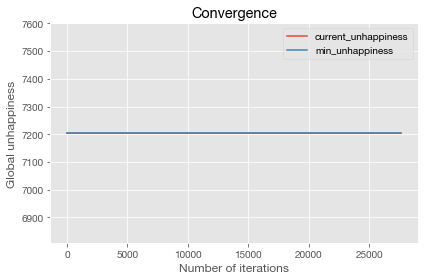

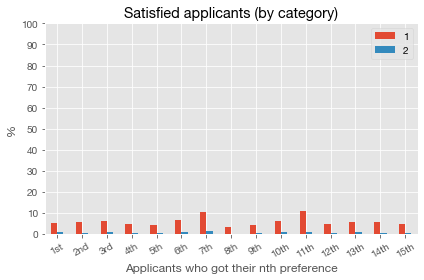

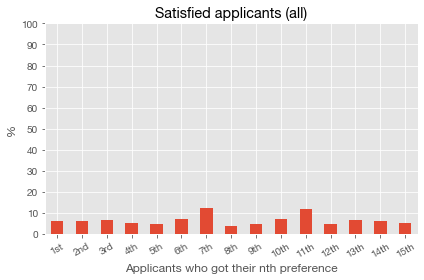

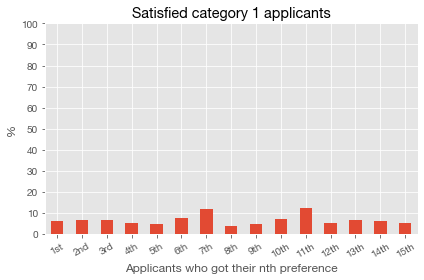

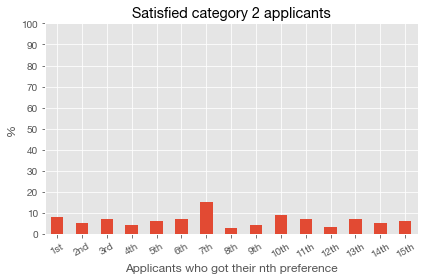

...

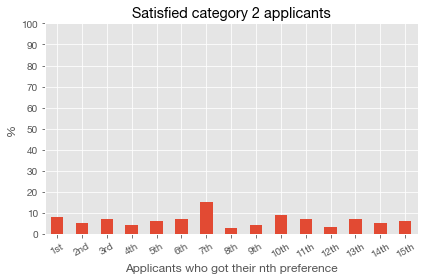

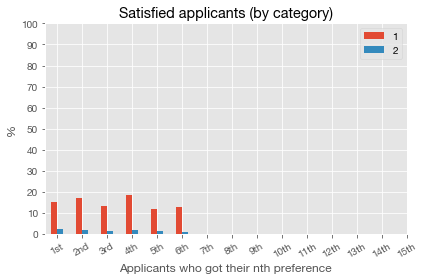

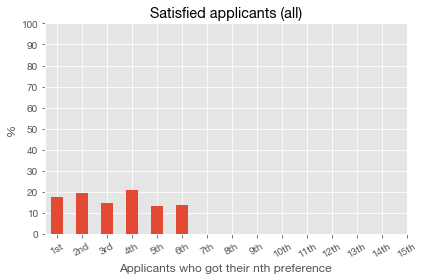

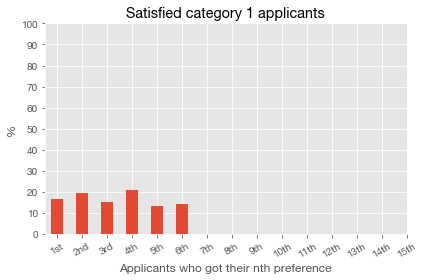

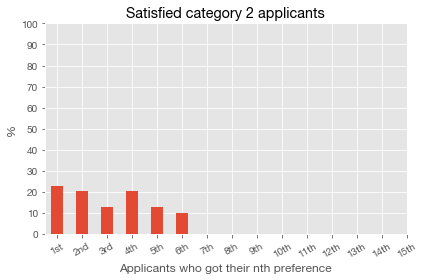

In [2]:
create_and_run_single_strategy_simulation("stack")

#### All random

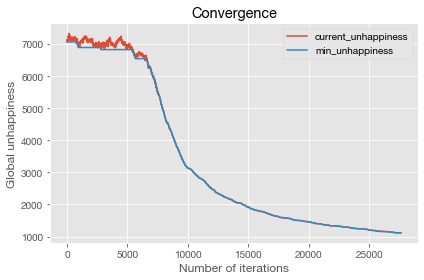

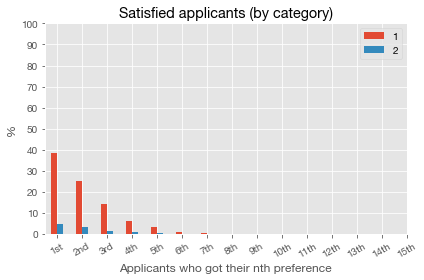

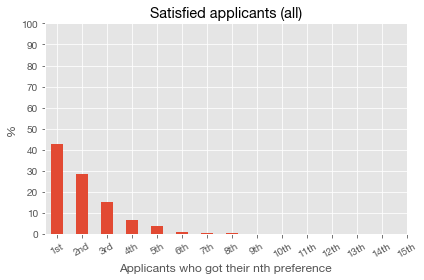

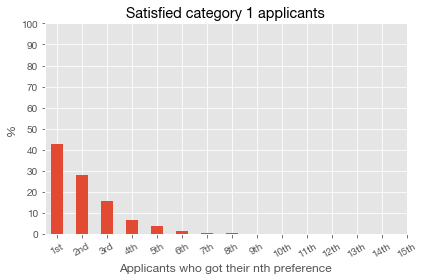

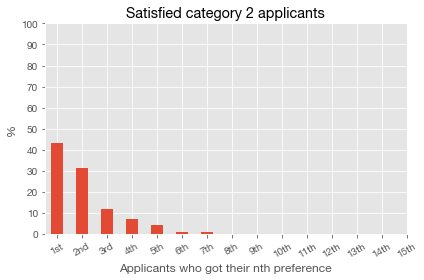

...

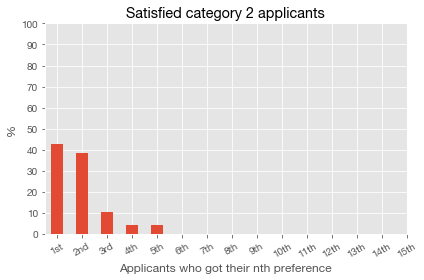

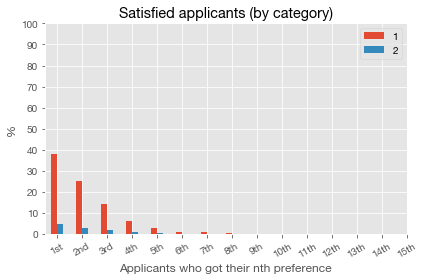

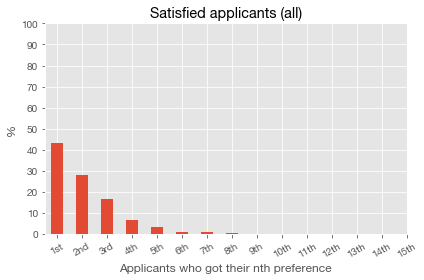

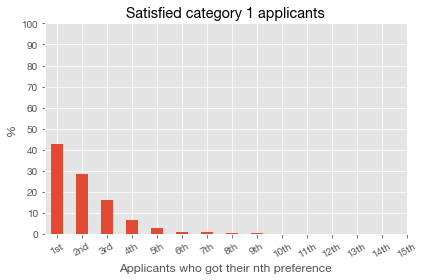

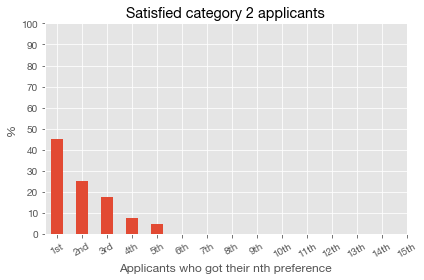

In [3]:
create_and_run_single_strategy_simulation("random")

#### Mixed stacks

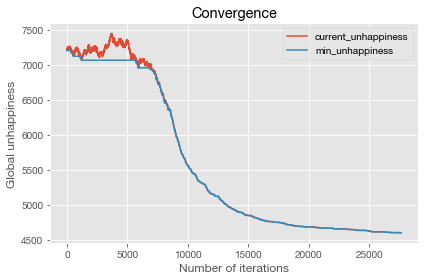

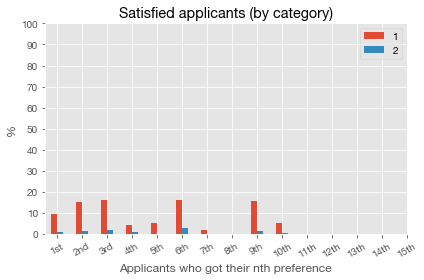

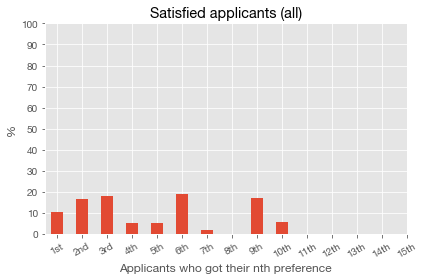

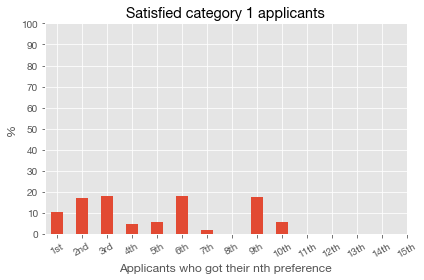

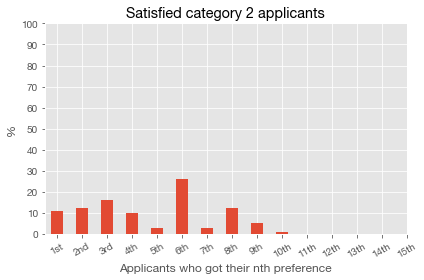

...

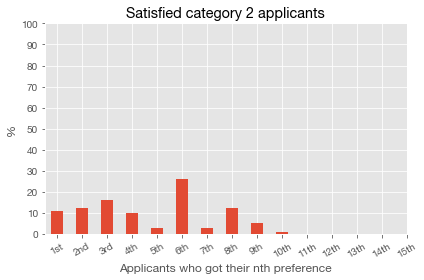

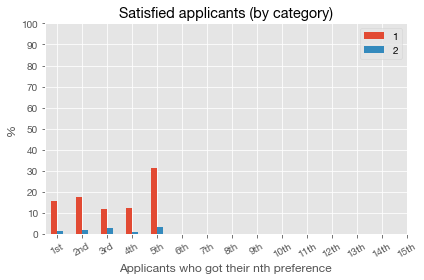

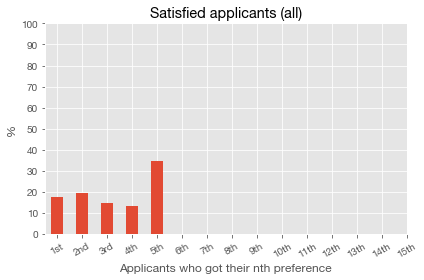

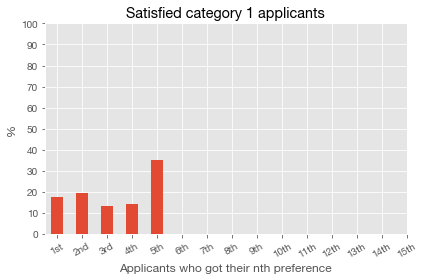

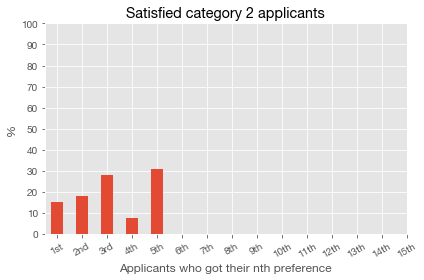

In [4]:
create_and_run_single_strategy_simulation("variant stack")

#### With all stacks identical

##### All stacks identical, random top

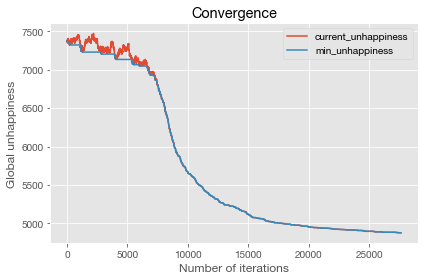

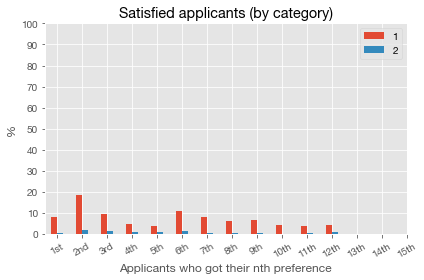

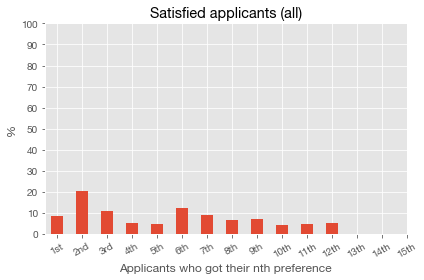

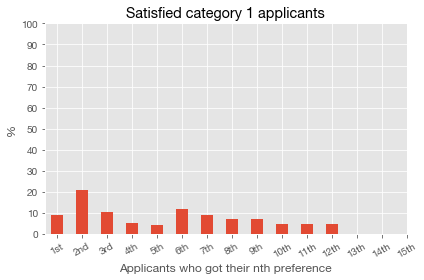

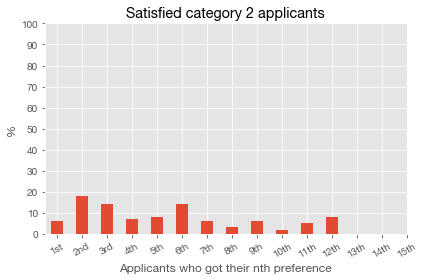

...

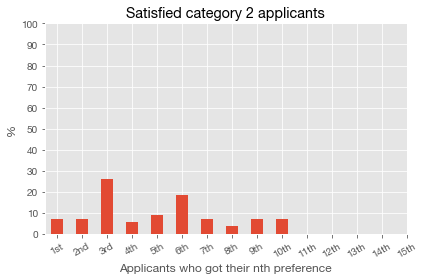

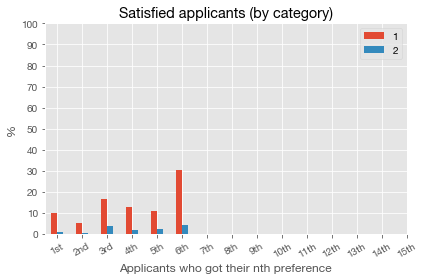

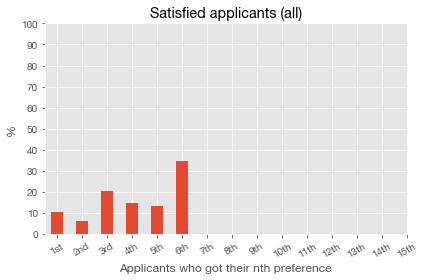

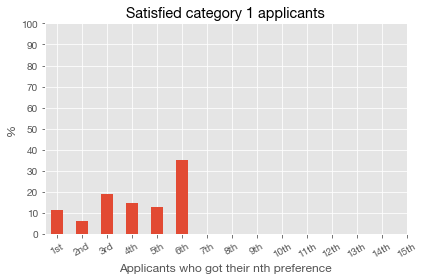

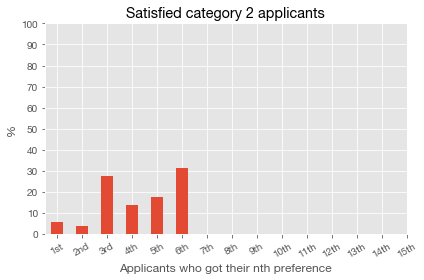

In [5]:
create_and_run_single_strategy_simulation("stack with random top")

##### All stacks identical, random top and 12th

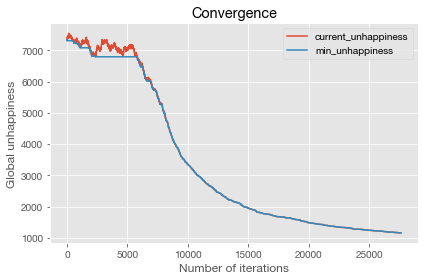

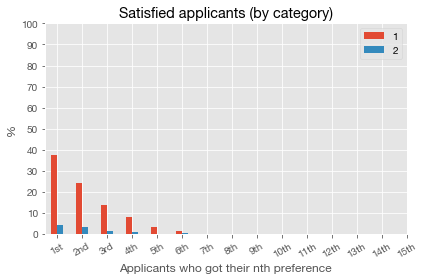

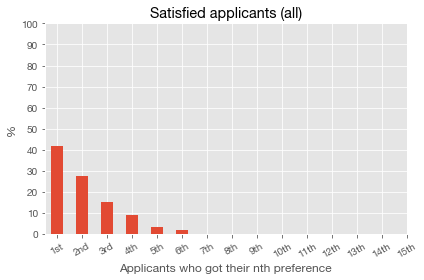

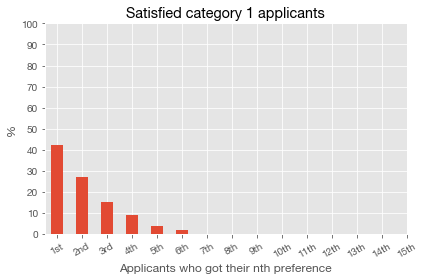

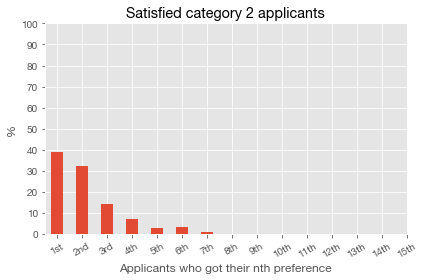

...

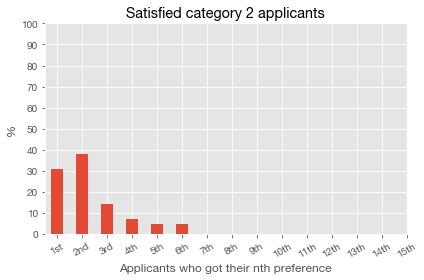

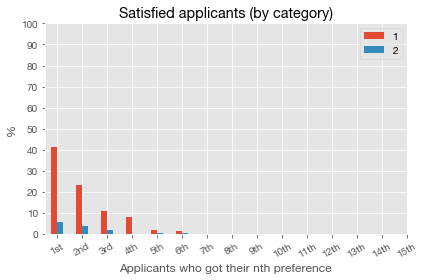

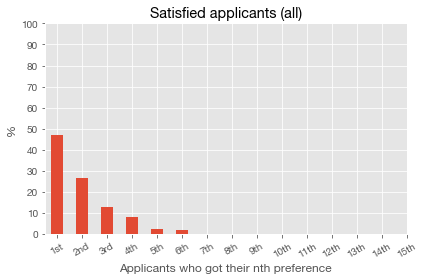

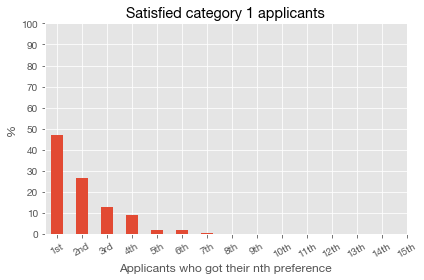

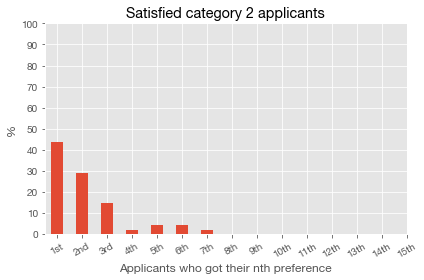

In [6]:
create_and_run_single_strategy_simulation("stack with random 1st and 12th")

##### All stacks identical, random top and 14th

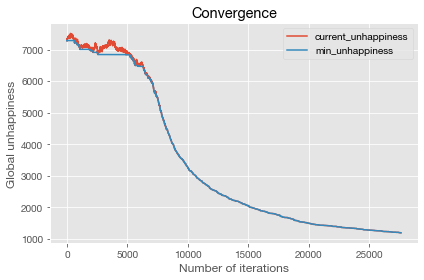

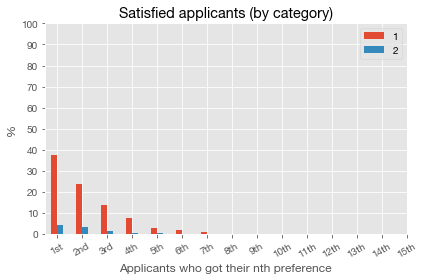

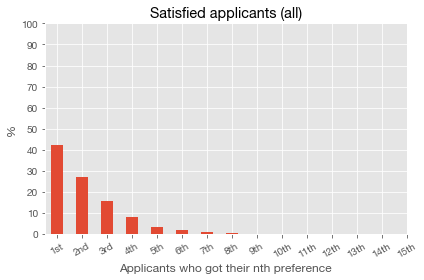

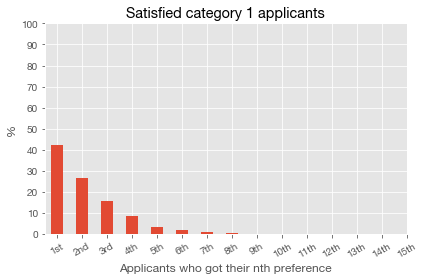

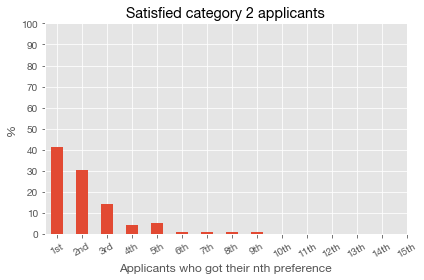

...

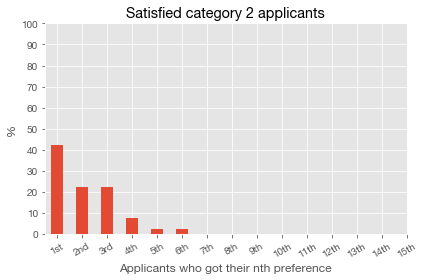

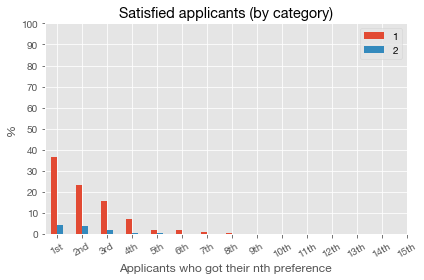

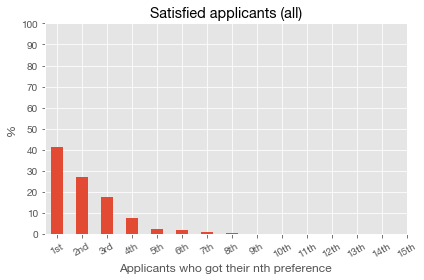

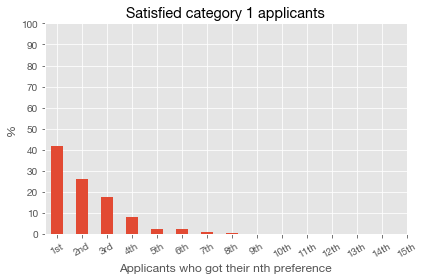

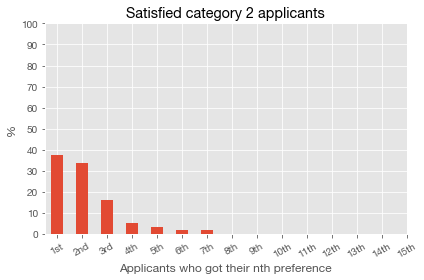

In [7]:
create_and_run_single_strategy_simulation("stack with random 1st and 14th")

#### With mixed stacks

##### Mixed stacks, random top

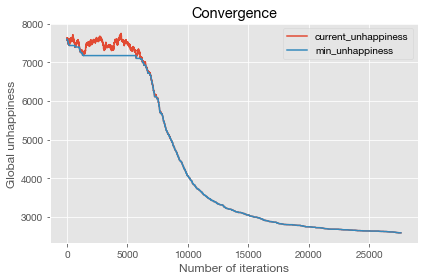

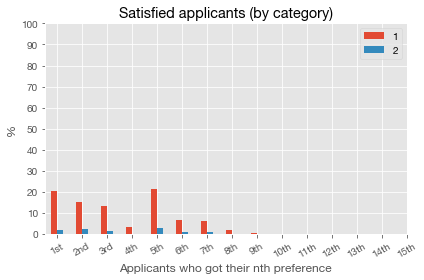

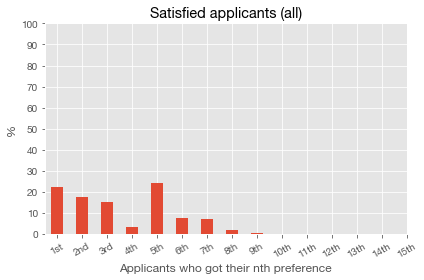

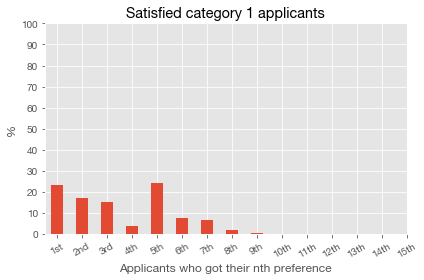

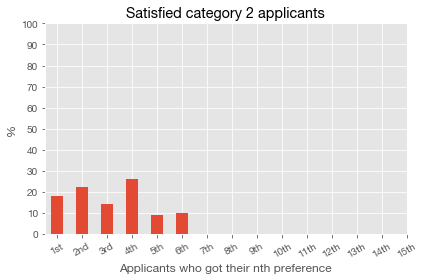

...

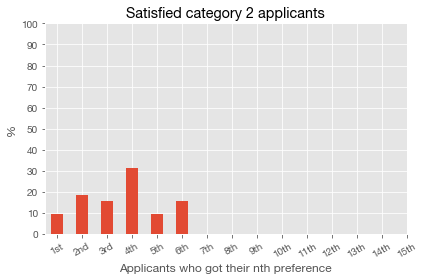

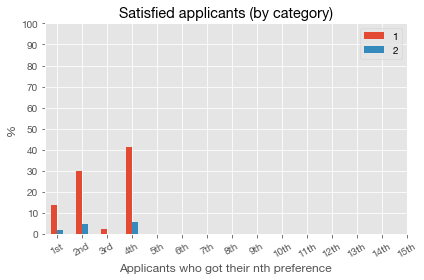

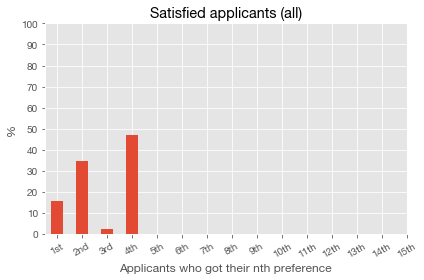

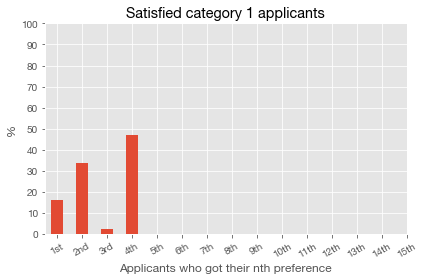

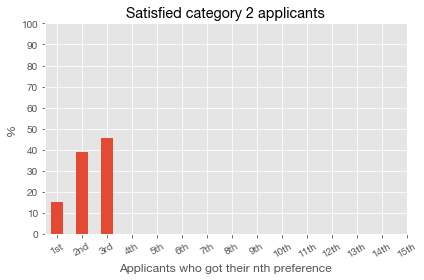

In [8]:
create_and_run_single_strategy_simulation("variant stack with random top")

##### Mixed stacks, random top and 12th

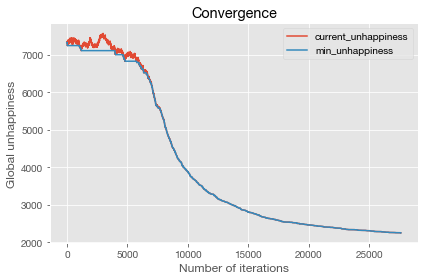

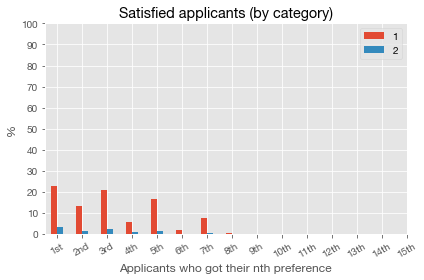

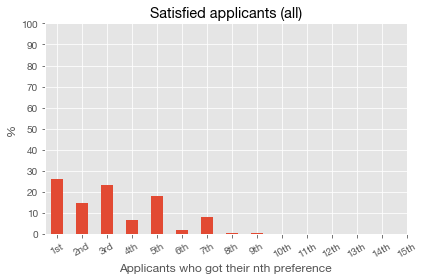

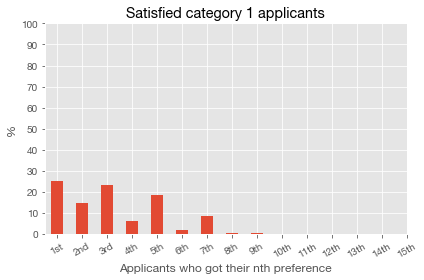

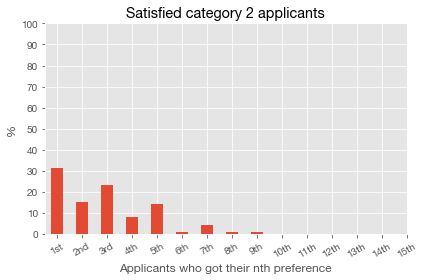

...

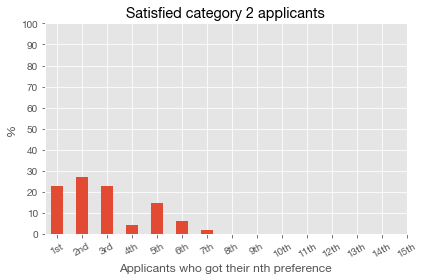

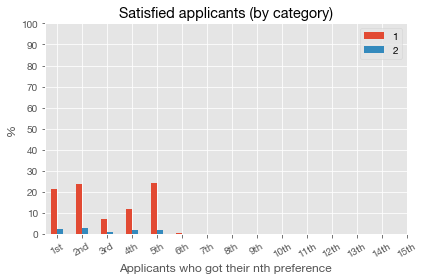

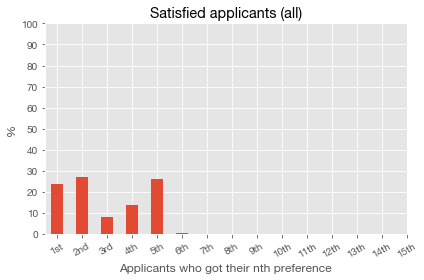

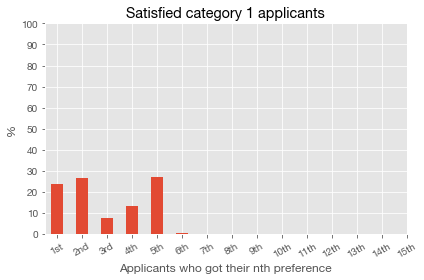

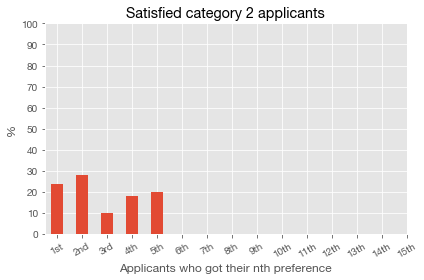

In [9]:
create_and_run_single_strategy_simulation("variant stack with random 1st and 12th")

##### Mixed stacks, random top and 14th

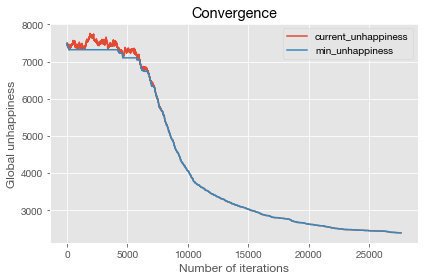

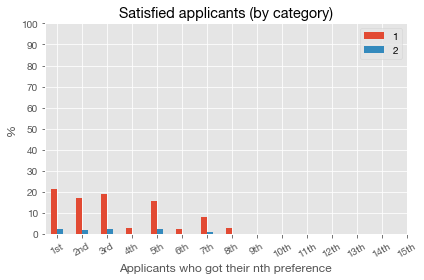

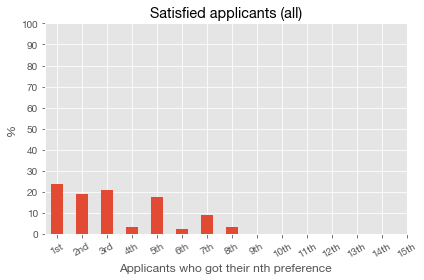

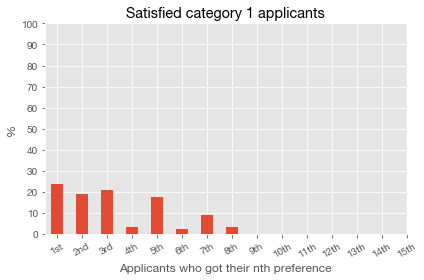

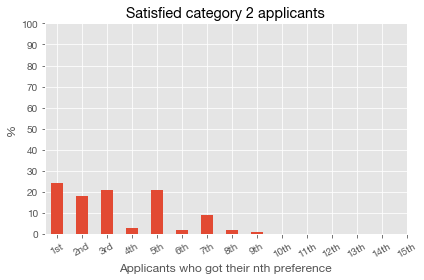

...

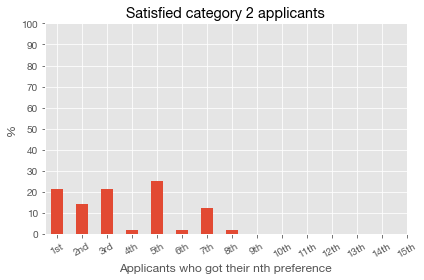

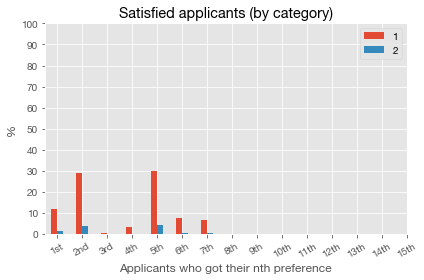

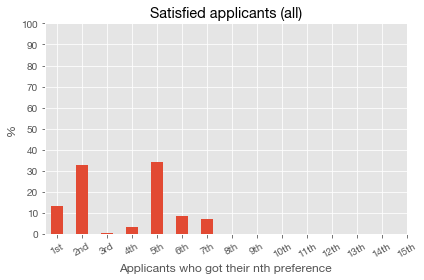

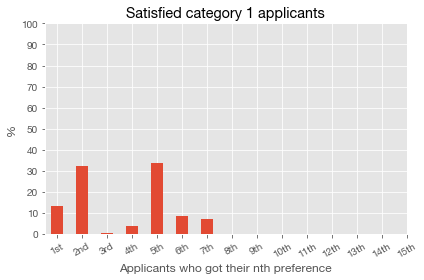

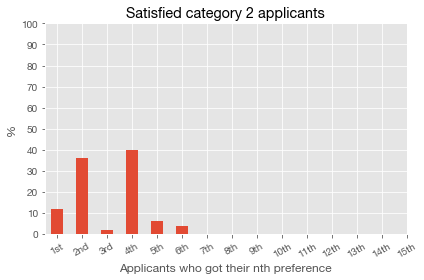

In [10]:
create_and_run_single_strategy_simulation("variant stack with random 1st and 14th")

### Mixed strategies

#### 80% stack with random first, 20% random

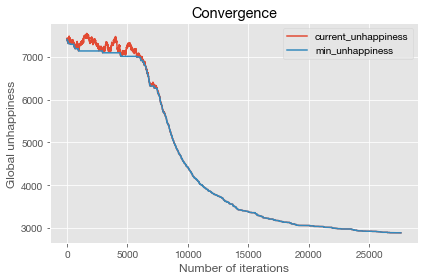

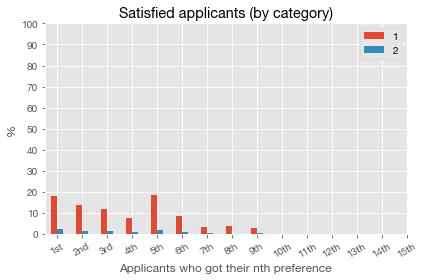

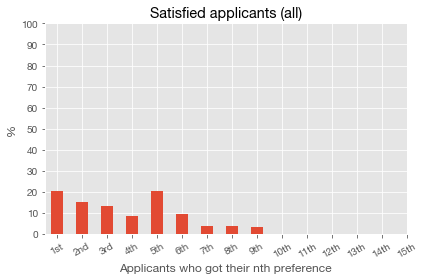

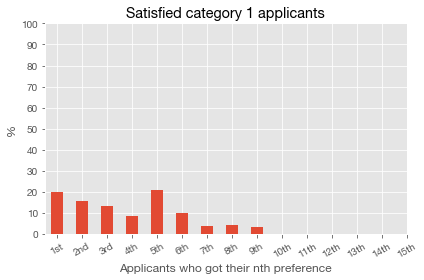

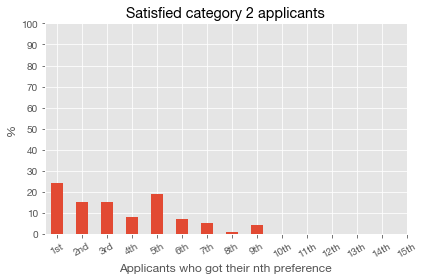

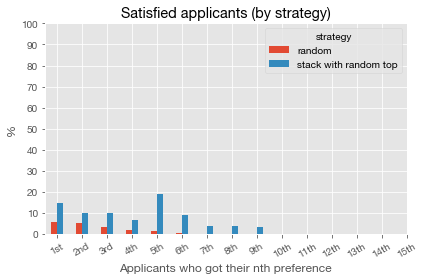

,random,stack with random top
Got first preference,30.16%,18.38%
Did not get first preference,69.84%,81.62%


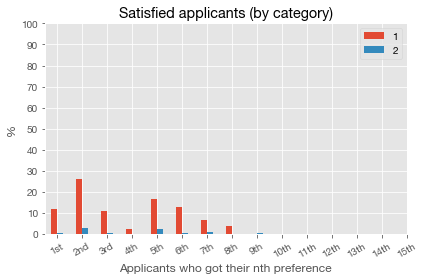

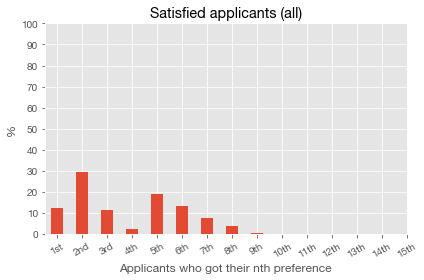

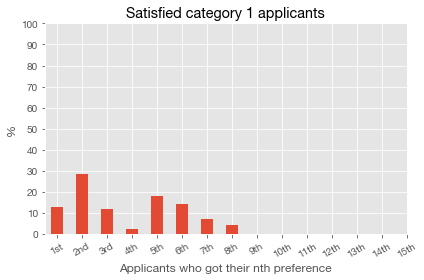

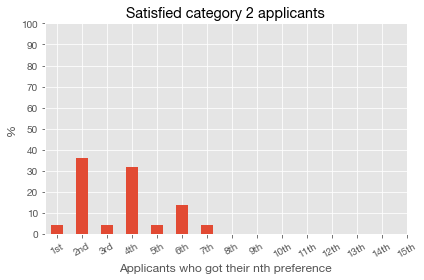

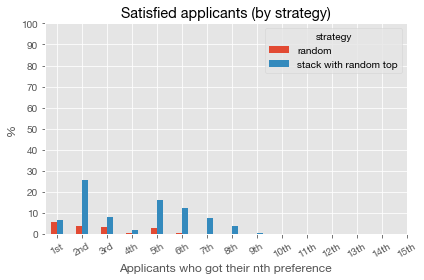

,random,stack with random top
Got first preference,33.33%,8.00%
Did not get first preference,66.67%,92.00%


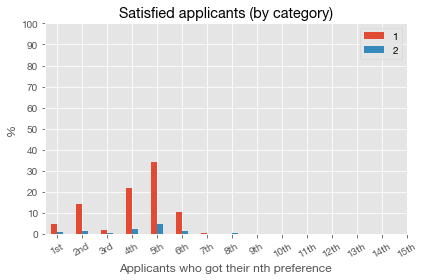

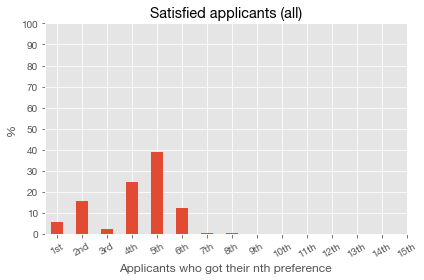

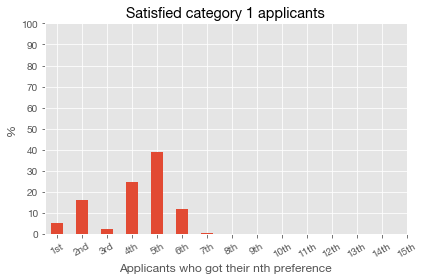

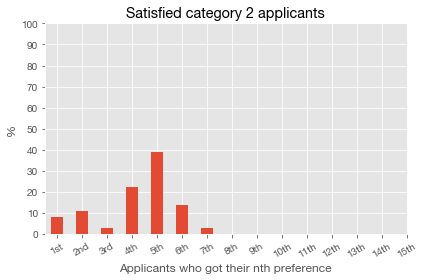

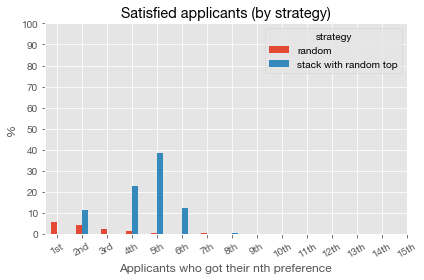

IndexError: too many indices for array

In [11]:
create_and_run_sim([
    ("stack with random top", 0.8),
    ("random", 0.2)
])

#### 60% stack with random first, 40% random

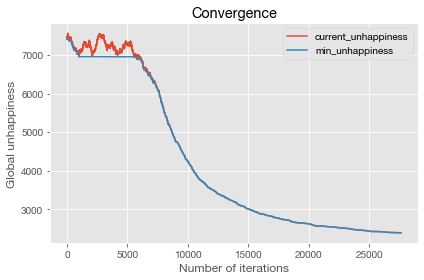

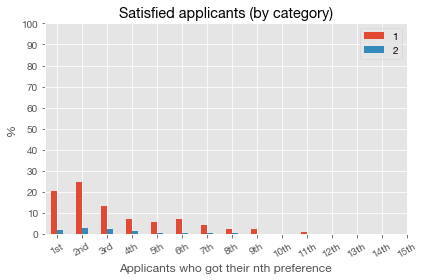

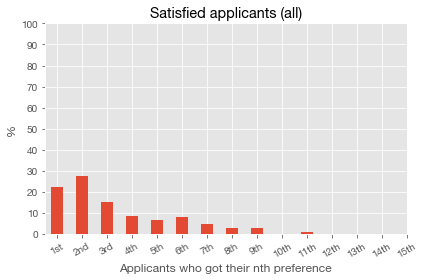

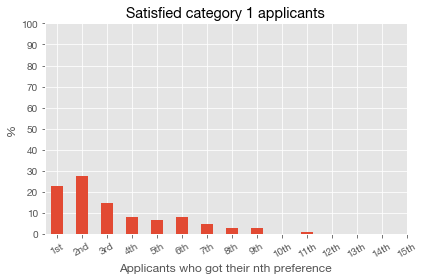

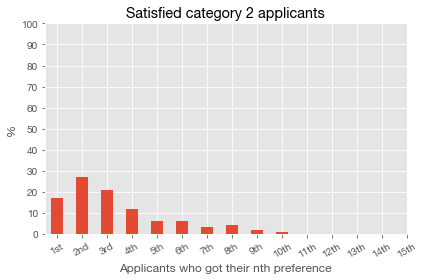

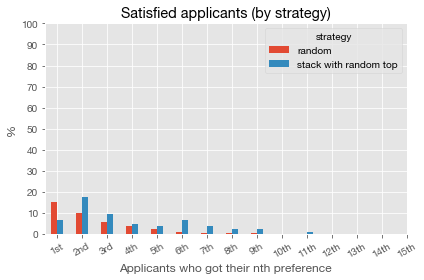

,random,stack with random top
Got first preference,38.26%,11.56%
Did not get first preference,61.74%,88.44%


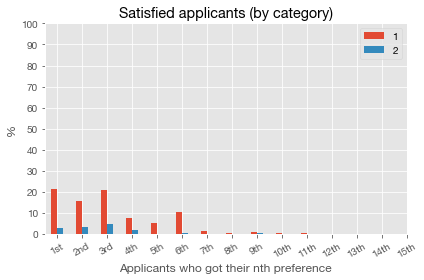

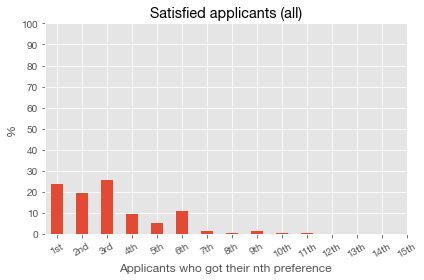

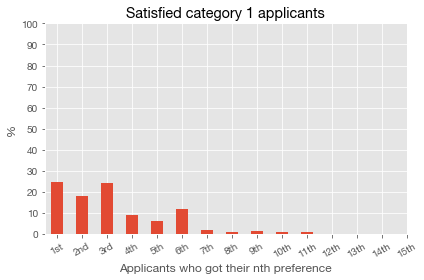

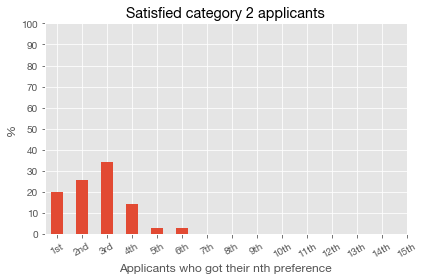

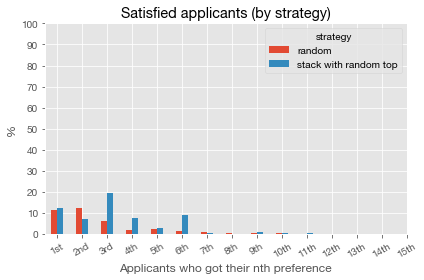

,random,stack with random top
Got first preference,30.00%,20.13%
Did not get first preference,70.00%,79.87%


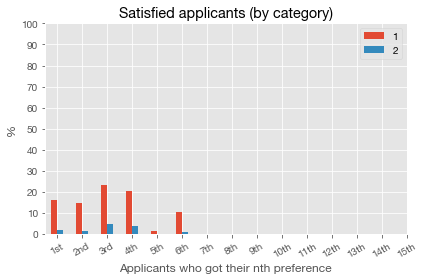

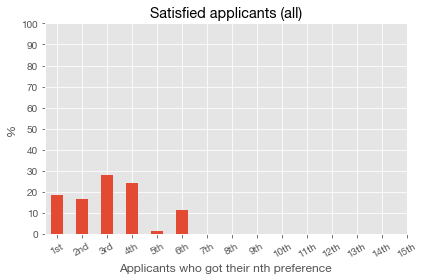

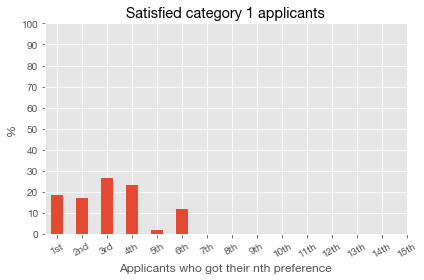

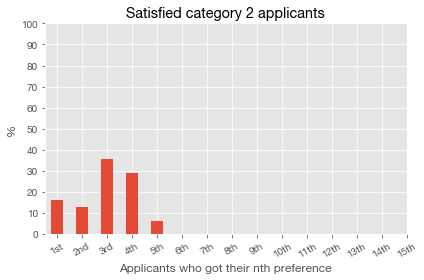

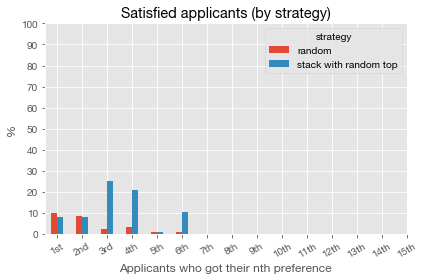

,random,stack with random top
Got first preference,38.10%,11.30%
Did not get first preference,61.90%,88.70%


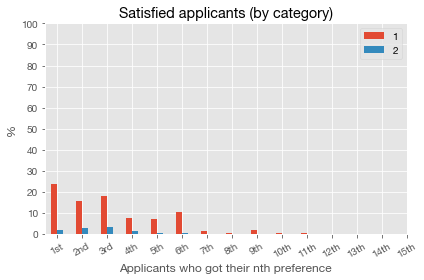

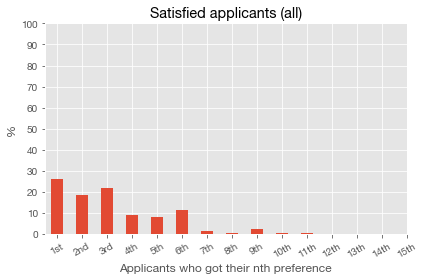

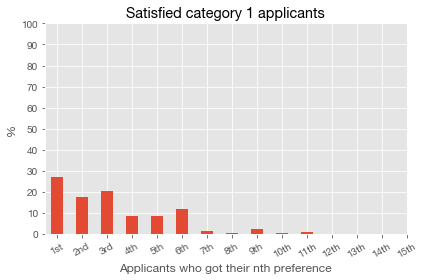

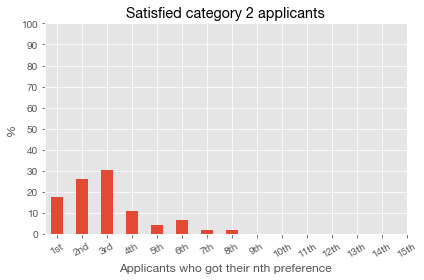

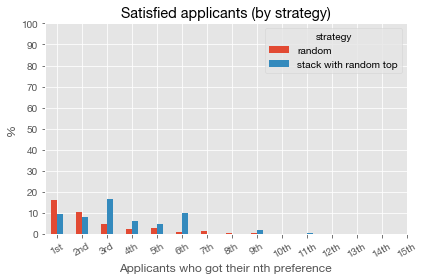

,random,stack with random top
Got first preference,39.75%,16.45%
Did not get first preference,60.25%,83.55%


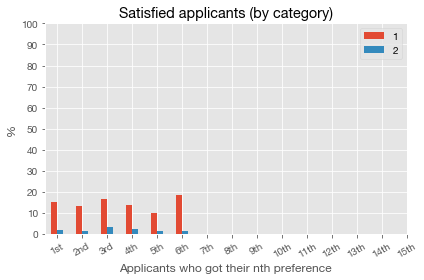

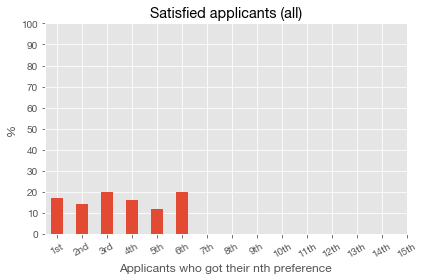

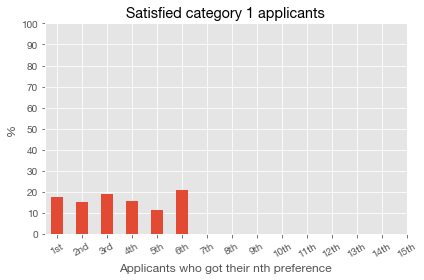

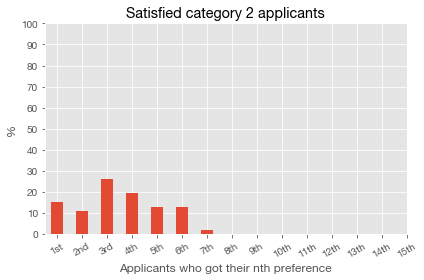

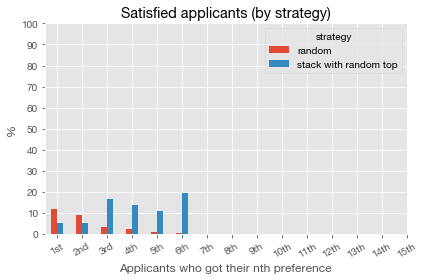

,random,stack with random top
Got first preference,41.35%,7.66%
Did not get first preference,58.65%,92.34%


In [5]:
create_and_run_sim([
    ("stack with random top", 0.6),
    ("random", 0.4)
])

#### 10% random with weighted random top, 30% mixed stacks, 60% default stack

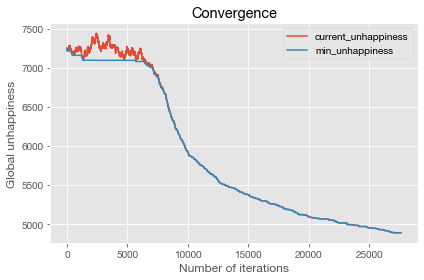

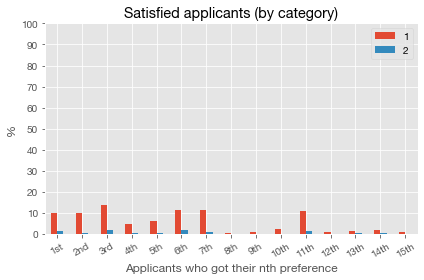

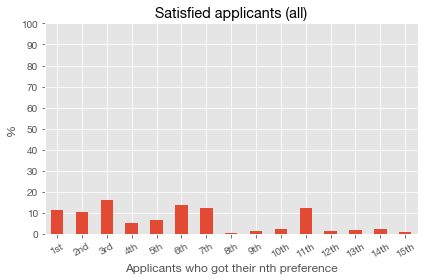

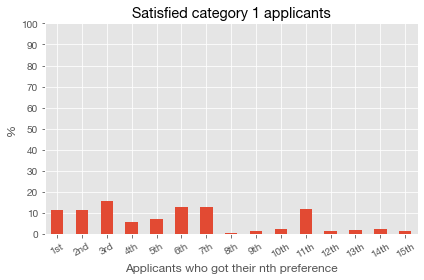

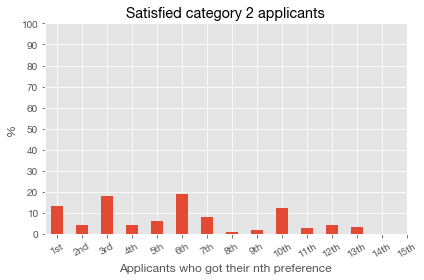

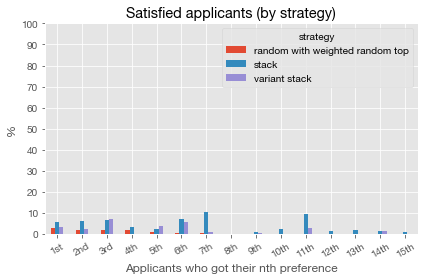

,random with weighted random top,stack,variant stack
Got first preference,24.35%,9.37%,11.26%
Did not get first preference,75.65%,90.63%,88.74%


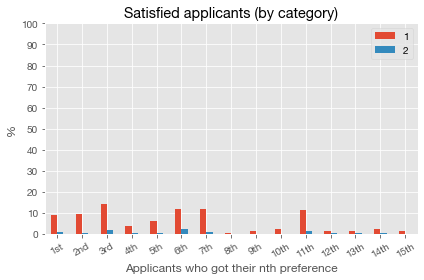

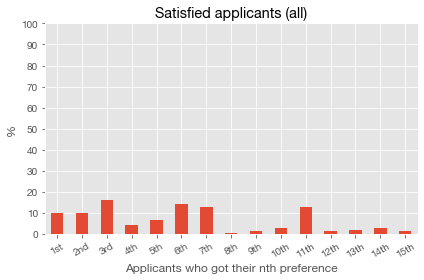

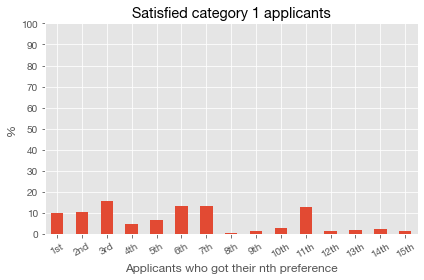

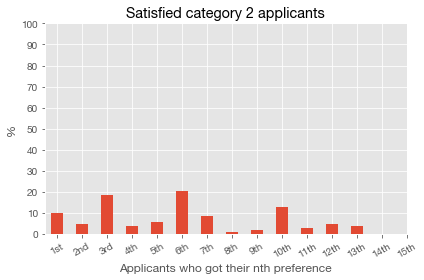

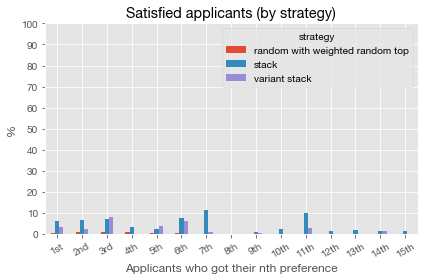

,random with weighted random top,stack,variant stack
Got first preference,12.20%,9.37%,11.26%
Did not get first preference,87.80%,90.63%,88.74%


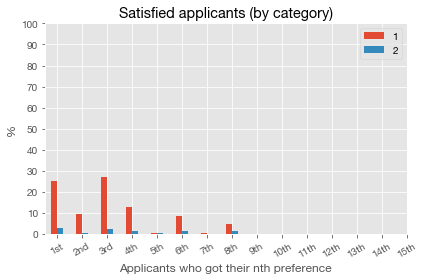

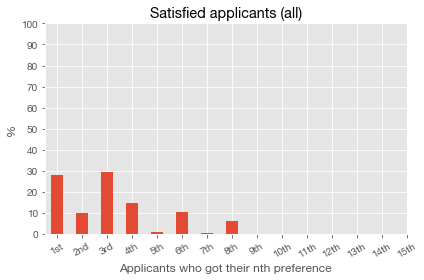

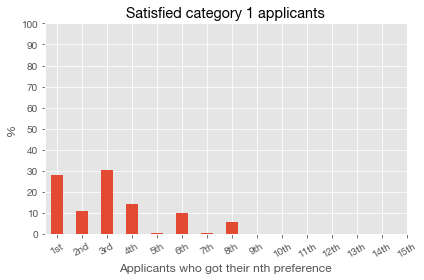

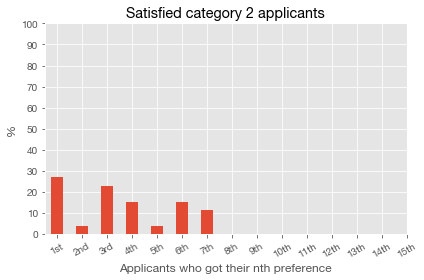

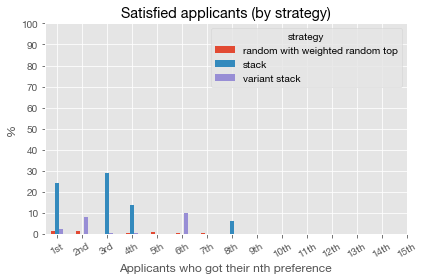

,random with weighted random top,stack,variant stack
Got first preference,25.00%,32.95%,11.54%
Did not get first preference,75.00%,67.05%,88.46%


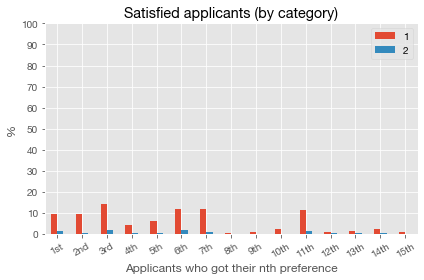

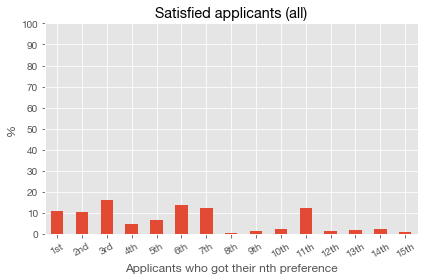

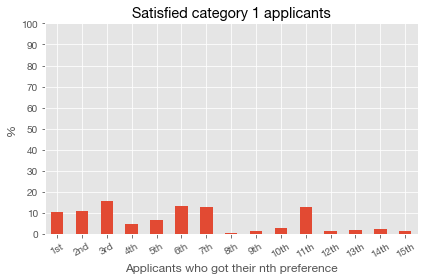

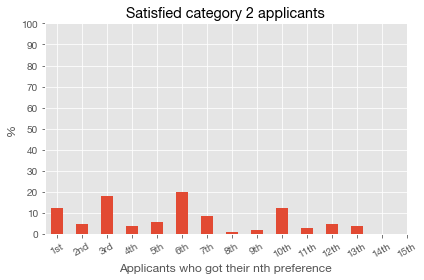

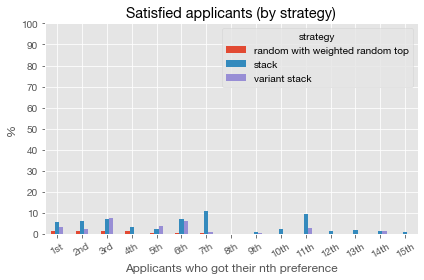

,random with weighted random top,stack,variant stack
Got first preference,21.13%,9.37%,11.26%
Did not get first preference,78.87%,90.63%,88.74%


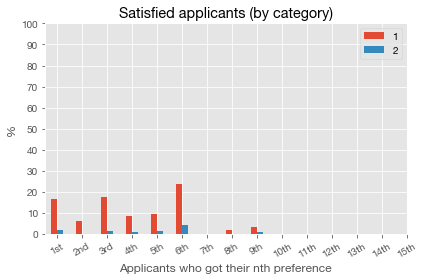

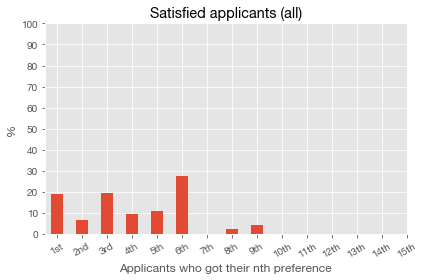

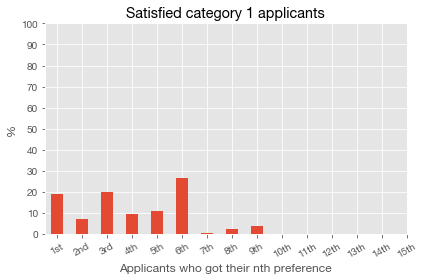

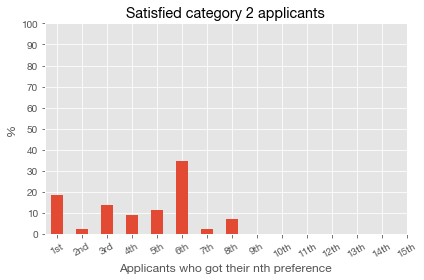

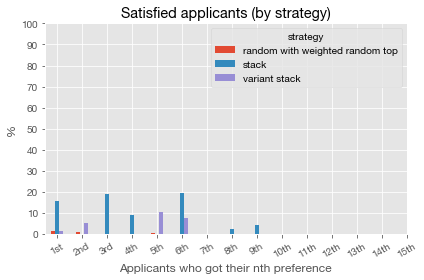

,random with weighted random top,stack,variant stack
Got first preference,35.71%,22.57%,6.38%
Did not get first preference,64.29%,77.43%,93.62%


In [6]:
create_and_run_sim([
    ("random with weighted random top", 0.1),
    ("variant stack", 0.3),
    ("stack", 0.6)
])

#### 15% random with weighted random top, 30% mixed stacks with weighted random top, 55% default stack with weighted random top

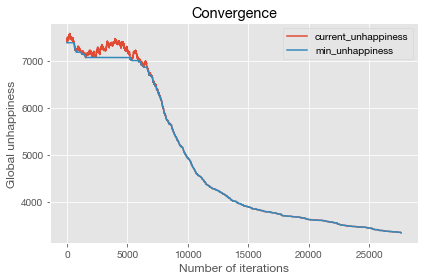

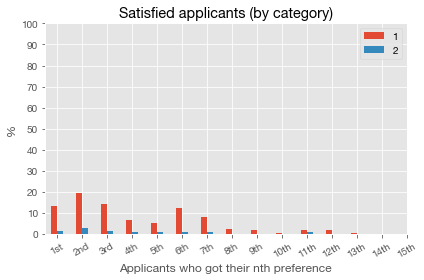

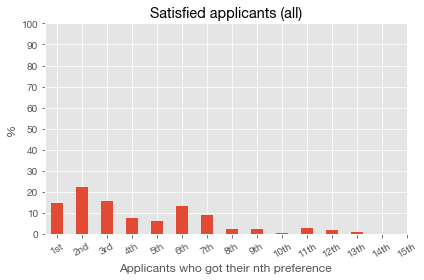

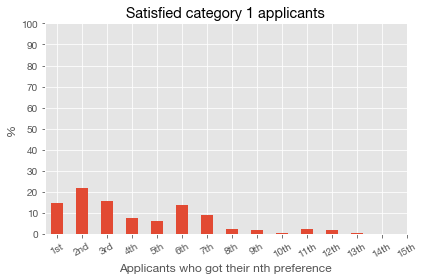

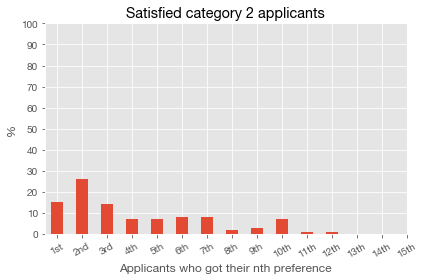

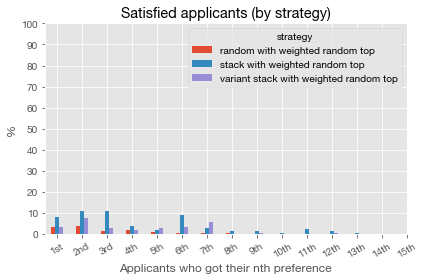

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,22.92%,14.68%,11.84%
Did not get first preference,77.08%,85.32%,88.16%


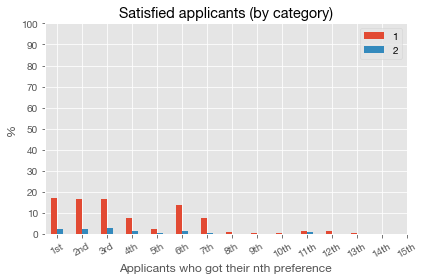

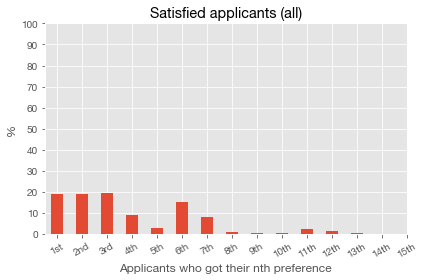

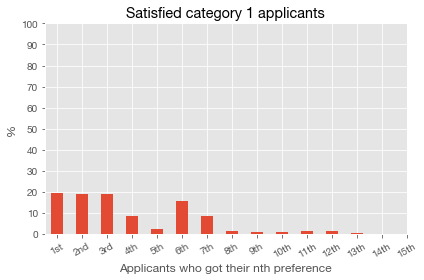

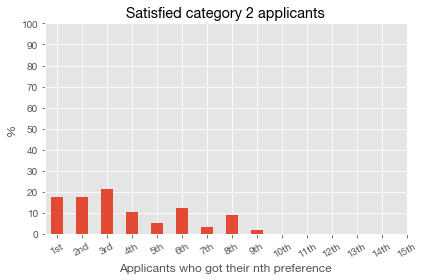

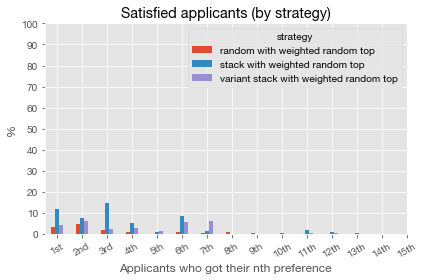

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,22.58%,21.58%,13.77%
Did not get first preference,77.42%,78.42%,86.23%


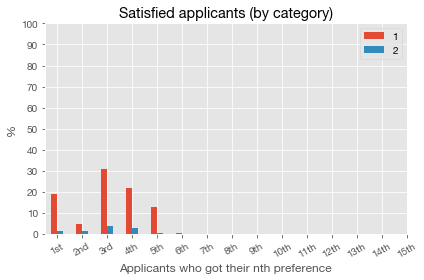

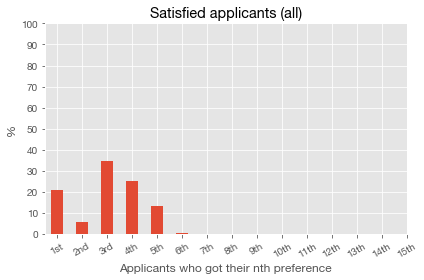

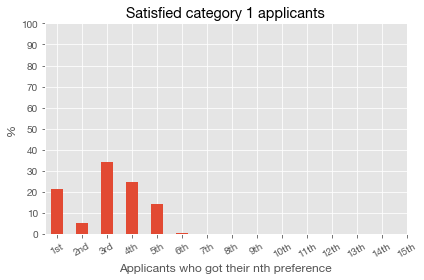

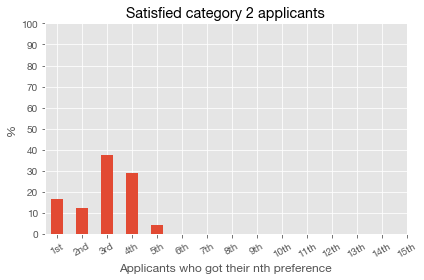

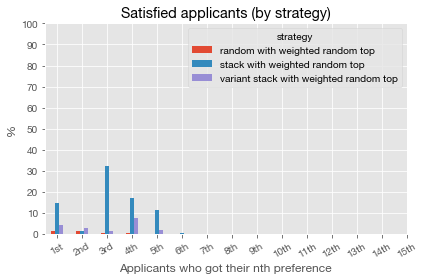

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,44.44%,19.25%,22.73%
Did not get first preference,55.56%,80.75%,77.27%


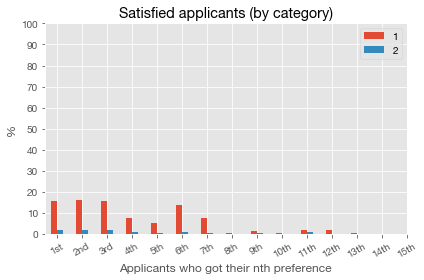

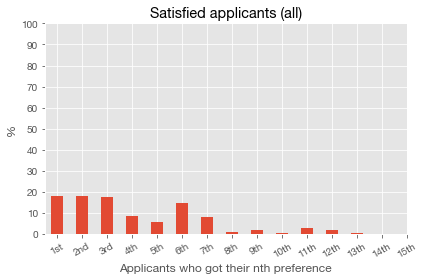

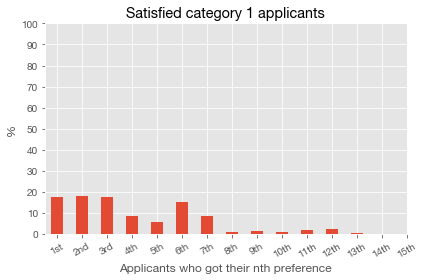

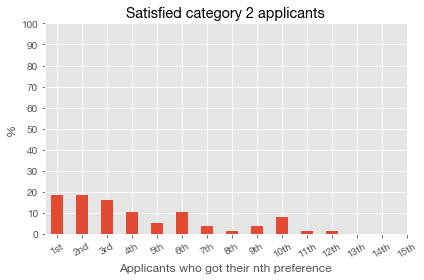

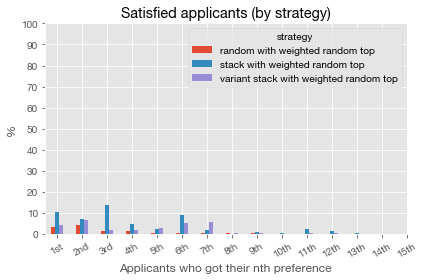

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,24.42%,18.75%,13.50%
Did not get first preference,75.58%,81.25%,86.50%


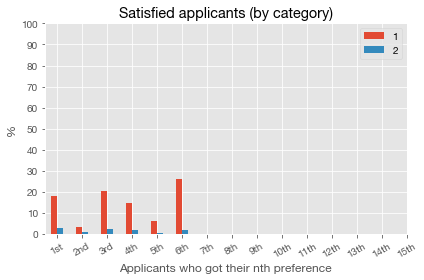

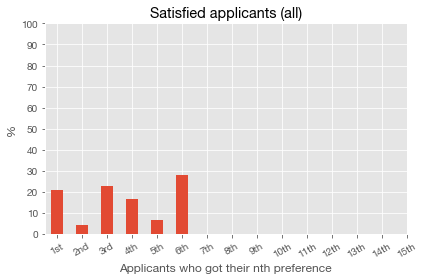

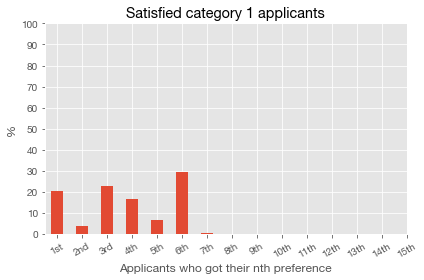

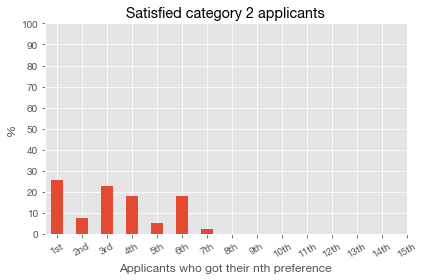

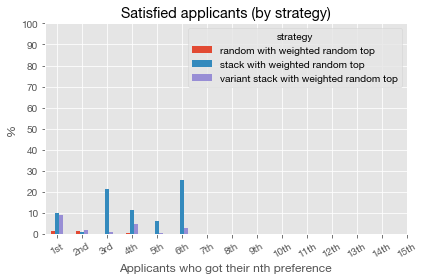

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,42.86%,13.09%,44.74%
Did not get first preference,57.14%,86.91%,55.26%


In [7]:
create_and_run_sim([
    ("random with weighted random top", 0.15),
    ("variant stack with weighted random top", 0.3),
    ("stack with weighted random top", 0.55)
])

#### 20% random with weighted random top, 25% mixed stacks with weighted random top, 55% default stack with weighted random top

In [8]:
create_and_run_sim([
    ("random with weighted random top", 0.2),
    ("variant stack with weighted random top", 0.25),
    ("stack with weighted random top", 0.55)
])

KeyboardInterrupt: 

#### 20% random with weighted random top, 50% mixed stacks with weighted random top, 30% default stack with weighted random top

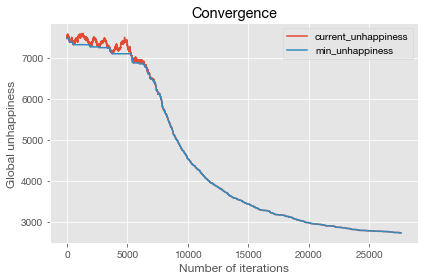

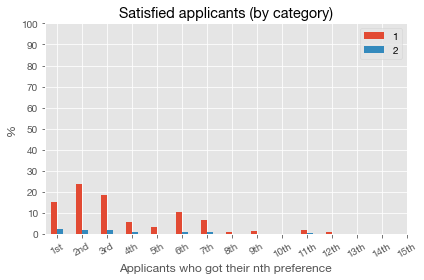

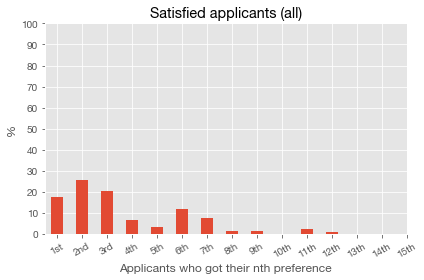

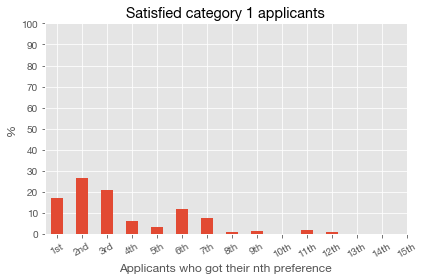

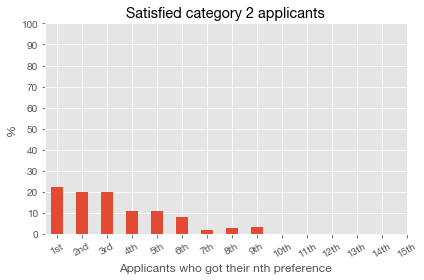

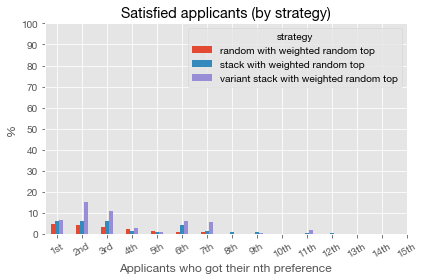

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,25.25%,20.66%,12.79%
Did not get first preference,74.75%,79.34%,87.21%


In [8]:
create_and_run_sim([
    ("random with weighted random top", 0.2),
    ("variant stack with weighted random top", 0.5),
    ("stack with weighted random top", 0.3)
])

#### 50% random with weighted random top, 25% mixed stacks with weighted random top, 25% default stack with weighted random top

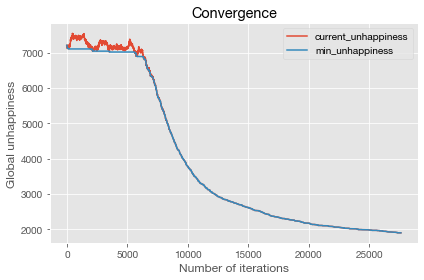

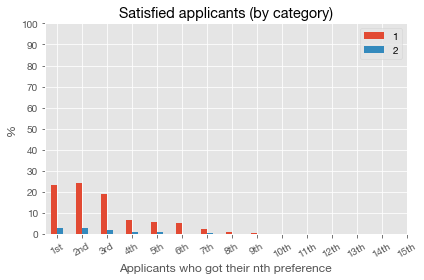

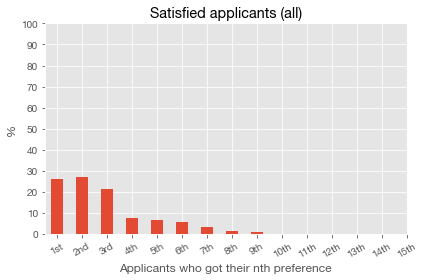

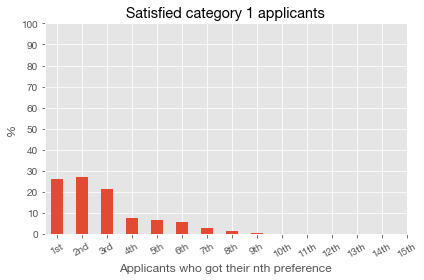

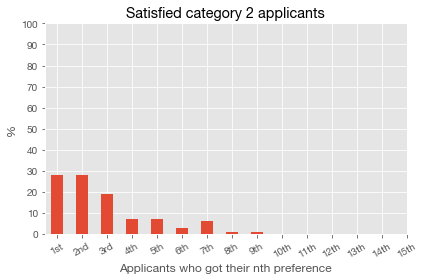

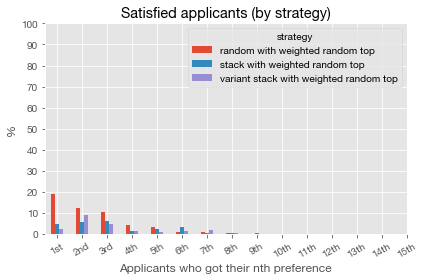

,random with weighted random top,stack with weighted random top,variant stack with weighted random top
Got first preference,36.72%,18.39%,11.06%
Did not get first preference,63.28%,81.61%,88.94%


In [9]:
create_and_run_sim([
    ("random with weighted random top", 0.5),
    ("variant stack with weighted random top", 0.25),
    ("stack with weighted random top", 0.25)
])

## Discussion

## Limitations

## Conclusion (what should you do?)

In [10]:
# Experiment with your own applicant pool simulation here

# Appendix: Alternatives to the current algorithm

It's evident that the current algorithm has some problems. What about some alternatives?

### Categorical allocation aka Queensland Ballot Algorithm

The idea with categorical allocation is that blah blah blah. This was lately proposed in an article by James Gates et al

Let's run our simulation using categorical allocation as the allocating algorithm and not simulated annealing.

### Discussion
As we can see this does not fix the problem of stacking. Furthermore, it seems to give Category 2 applicants a much worse deal than Category 1.